## Main figures

## Figure 4: Variance explained by principal components of vegetation variables

### Estupinan-Suarez,  et al. (2021). A Regional Earth System Data Lab for Understanding Ecosystem Dynamics: An Example from Tropical South America. Front. Earth Sci. 9:613395. doi: 10.3389/feart.2021.613395
#### Correspondence to: lestup@bgc-jena.mpg.de, linamaesu@gmail.com
#### GitHub repository: https://github.com/linamaes/Regional_ESDL

This script does the following:
- Gap fills and standarized data to zero mean and variance of 1
- Computes Principal Component Analysis (PCA) for vegetation variables i.e., GPP, NDVI, EVI, FAPAR
- Calculates the significance of each principal component (PC)
- Extracts loading values of each component
- Computes the mean seasonal cycle (MSC) and standard deviation seasonal cycle (SDSC) of the first PC

About the notebook:
- It is written in Julia 1.3
- "#" comments in the code are intended to explain specific aspects of the coding
- New steps in workflows are introduced with bold headers

April 2021, Max Planck Institute for Biogeochemistry, Jena, Germany

## Load packages

In [1]:
using ESDL

In [2]:
using ESDLPlots

HTML{String}("<script>\n// Immediately-invoked-function-expression to avoid global variables.\n(function() {\n    var warning_div = document.getElementById(\"webio-warning-20225921840336982\");\n    var hide = function () {\n        var script = document.getElementById(\"webio-setup-4687466058742661584\");\n        var parent = script && script.parentElement;\n        var grandparent = parent && parent.parentElement;\n        if (grandparent) {\n            grandparent.style.display = \"none\";\n        }\n        warning_div.style.display = \"none\";\n    };\n    if (typeof Jupyter !== \"undefined\") {\n        console.log(\"WebIO detected Jupyter notebook environment.\");\n        // Jupyter notebook.\n        var extensions = (\n            Jupyter\n            && Jupyter.notebook.config.data\n            && Jupyter.notebook.config.data.load_extensions\n        );\n        if (extensions && extensions[\"webio-jupyter-notebook\"]) {\n            // Extension already loaded.\n            console.log(\"Jupyter WebIO nbextension detected; not loading ad-hoc.\");\n            hide();\n            return;\n        }\n    } else if (window.location.pathname.includes(\"/lab\")) {\n        // Guessing JupyterLa\n        console.log(\"Jupyter Lab detected; make sure the @webio/jupyter-lab-provider labextension is installed.\");\n        hide();\n        return;\n    }\n})();\n\n</script>\n<p\n    id=\"webio-warning-20225921840336982\"\n    class=\"output_text output_stderr\"\n    style=\"padding: 1em; font-weight: bold;\"\n>\n    Unable to load WebIO. Please make sure WebIO works for your Jupyter client.\n    For troubleshooting, please see <a href=\"https://juliagizmos.github.io/WebIO.jl/latest/providers/ijulia/\">\n    the WebIO/IJulia documentation</a>.\n    <!-- TODO: link to installation docs. -->\n</p>\n")

In [3]:
using CSV

In [4]:
using Missings

In [5]:
using Plots

In [6]:
using MultivariateStats

In [7]:
using OnlineStats

In [8]:
using DelimitedFiles

In [9]:
using Distributed

In [10]:
using NPZ

In [11]:
using Statistics

In [12]:
gr(size=(600,400))
default(fmt = :png)

## Load RegESDL for temporal analysis

In [13]:
pathin = "/my_path/.../"

"/my_path/.../"

In [15]:
# High spatial resolution
c = Cube(string(pathin, "Cube_2020highColombiaCube_184x120x120.zarr/"))

# Low spatial resolution 
# c = Cube(string(pathin, "Cube_2020lowColombiaCube_184x60x60.zarr/"))

Collection of ZArray Cube with the following dimensions
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Time                Axis with 782 Elements from 2001-01-05T00:00:00 to 2017-12-31T00:00:00
Variable            Axis with 5 elements: lai fpar gross_primary_productivity evi ndvi 
Total size: 168.85 GB


## Parameters for data subsets

In [16]:
csub = c[time=2001:2014, var=["gross_primary_productivity", "ndvi", 
        "evi","fpar"]]#

Collection of ZArray Cube with the following dimensions
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Time                Axis with 644 Elements from 2001-01-05T00:00:00 to 2014-12-31T00:00:00
Variable            Axis with 4 elements: gross_primary_productivity ndvi evi fpar 
Total size: 111.24 GB


In [17]:
# Set time for plotting
t = Date(2014, 1, 31)

2014-01-31

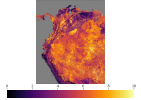

In [18]:
plotMAP(csub, time=t, variable="gross_primary_productivity", dmin=0, dmax=10)

## Load mask

In [19]:
pathcsv = "/my_mask_path/.../"

"/my_mask_path/.../"

In [20]:
pathcsv = "/Net/Groups/BGI/people/lestup/ESDLreg/output/csv/"

"/Net/Groups/BGI/people/lestup/ESDLreg/output/csv/"

In [21]:
maskin = CSV.read(string(pathcsv, "msc_missings_mask.csv"), header=false);

In [22]:
maskin = Matrix(maskin);

In [23]:
mask = map(x-> isnan(x) ? missing : x==0 ? missing : x, maskin' |> Array);

In [24]:
csub

Collection of ZArray Cube with the following dimensions
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Time                Axis with 644 Elements from 2001-01-05T00:00:00 to 2014-12-31T00:00:00
Variable            Axis with 4 elements: gross_primary_productivity ndvi evi fpar 
Total size: 111.24 GB


In [25]:
# lonaxis = RangeAxis("Lon", lon)
# lataxis = RangeAxis("Lat", lat)
lonaxis = csub.cubeaxes[1]
lataxis = csub.cubeaxes[2]

Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735

In [26]:
# Create a cube from the mask
cmask = CubeMem(CubeAxis[lonaxis, lataxis], mask)

In-Memory data cube with the following dimensions
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Total size: 79.6 MB


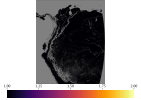

In [27]:
plotMAP(cmask)

## Settings for Parallel Processing

In [28]:
workers()

1-element Array{Int64,1}:
 1

In [29]:
## add workers
addprocs(6)

6-element Array{Int64,1}:
 2
 3
 4
 5
 6
 7

## Define missings

In [30]:
csub

Collection of ZArray Cube with the following dimensions
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Time                Axis with 644 Elements from 2001-01-05T00:00:00 to 2014-12-31T00:00:00
Variable            Axis with 4 elements: gross_primary_productivity ndvi evi fpar 
Total size: 111.24 GB


In [31]:
csub2 = map(x-> ismissing(x) ? missing : x==255.0 ? missing : x==65335.0 ? missing : x, csub)

Transformed cube Collection of ZArray Cube with the following dimensions
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Time                Axis with 644 Elements from 2001-01-05T00:00:00 to 2014-12-31T00:00:00
Variable            Axis with 4 elements: gross_primary_productivity ndvi evi fpar 
Total size: 111.24 GB


In [32]:
#csub2 = mapCube(maskout, csub[lat=lat, lon=lon], mask, indims=indims, outdims=outdims)

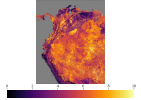

In [33]:
plotMAP(csub2, time=t, variable="gross_primary_productivity", dmin=0, dmax=10)

### Gap-filling

In [34]:
#cfill = gapFillMSC(csub)
@time cfill = gapFillMSC(csub2)

Progress: 100%|█████████████████████████████████████████| Time: 0:05:25


365.476447 seconds (26.38 M allocations: 1.306 GiB, 0.08% gc time)


Collection of ZArray Cube with the following dimensions
Time                Axis with 644 Elements from 2001-01-05T00:00:00 to 2014-12-31T00:00:00
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Variable            Axis with 4 elements: gross_primary_productivity ndvi evi fpar 
Total size: 111.24 GB


In [35]:
cfill

Collection of ZArray Cube with the following dimensions
Time                Axis with 644 Elements from 2001-01-05T00:00:00 to 2014-12-31T00:00:00
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Variable            Axis with 4 elements: gross_primary_productivity ndvi evi fpar 
Total size: 111.24 GB


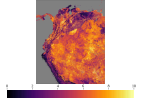

In [36]:
plotMAP(cfill, time=t, variable="gross_primary_productivity", dmin=0, dmax=10)

### Standarized function

In [37]:
@everywhere using OnlineStats

In [38]:
# Variables are standardized to zero mean and variance of 1

@everywhere function stdFx(xout, xin)
    xout[:] .= map(x -> (x - OnlineStats.mean(xin))/sqrt(var(xin)), xin)
end

In [39]:
indimsstd = InDims("Time")
outdimsstd = OutDims("Time")

OutDims((ESDL.Cubes.Axes.ByName("Time"),), (), zero, identity, :auto, false, AsArray(), :input, Zarr.NoCompressor(), "", false, 1)

In [40]:
#@time
cstd = mapCube(stdFx, cfill, indims = indimsstd, outdims = outdimsstd)

Progress: 100%|█████████████████████████████████████████| Time: 0:25:48


Collection of ZArray Cube with the following dimensions
Time                Axis with 644 Elements from 2001-01-05T00:00:00 to 2014-12-31T00:00:00
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Variable            Axis with 4 elements: gross_primary_productivity ndvi evi fpar 
Total size: 111.24 GB


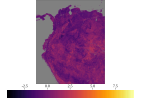

In [41]:
plotMAP(cstd, time=t, variable="gross_primary_productivity")

## PC significance and loading values from PCA

In [42]:
# addprocs(8)

In [43]:
workers();

6-element Array{Int64,1}:
 2
 3
 4
 5
 6
 7

In [44]:
# rmprocs(workers())

In [45]:
@everywhere using MultivariateStats

In [46]:
@everywhere using ESDL

In [47]:
@everywhere function pcaSigFx(xout, xin0::Any, loopvars, maxoutdim=4, method=:svd)
    #@show loopvars
    if any(ismissing.(xin0))
        return missing
    else
       #@show size(xin0)
       xin = convert(Array{Float32}, xin0' |> Matrix) 
        # projection(pca) give the rotation matrix
        xin_pca = fit(PCA, xin; maxoutdim=maxoutdim,  method=method, pratio=1.0)
       #@show size(xout) 
        xout[:,1] .= (principalvars(xin_pca) ./ tprincipalvar(xin_pca))
        xout[:,2:4] .= projection(xin_pca)[:,1:3]
        return xout
    
    end
end

In [48]:
sigaxis = CategoricalAxis("info_PCA", ["PC_Significance","LoadingPC1", "LoadingPC2",
        "LoadingPC3"])#,, "LoadingPC4"

varsigaxis = CategoricalAxis("Components_or_Var", ["sigPC_var1","sigPC_var2","sigPC_var3", "sigPC_var4"]) #,"sigPC_var4"

Components_or_Var   Axis with 4 elements: sigPC_var1 sigPC_var2 sigPC_var3 sigPC_var4 

In [49]:
indims = InDims("Time","Variable")
outdims = OutDims(varsigaxis, sigaxis)

OutDims((ESDL.Cubes.Axes.ByValue(Components_or_Var   Axis with 4 elements: sigPC_var1 sigPC_var2 sigPC_var3 sigPC_var4 ), ESDL.Cubes.Axes.ByValue(info_PCA            Axis with 4 elements: PC_Significance LoadingPC1 LoadingPC2 LoadingPC3 )), (), zero, identity, :auto, false, AsArray(), :input, Zarr.NoCompressor(), "", false, 1)

In [50]:
cstd

Collection of ZArray Cube with the following dimensions
Time                Axis with 644 Elements from 2001-01-05T00:00:00 to 2014-12-31T00:00:00
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Variable            Axis with 4 elements: gross_primary_productivity ndvi evi fpar 
Total size: 111.24 GB


In [51]:
########################################
# NOTE for axes interpretation:
# 'Components_or_Var' has a different meaning based on the 'info_PCA' class, as follows:
#  For 'PC_Significance' the values are  significance of PC1, PC2, PC3 and PC4 respectively
#  For 'LoadingsPC1/2/3' the values are the loadings of variable 1, 2, 3, and 4 respectively
#  Check the variables order from the input data.
########################################

@time pcasiglod = mapCube(pcaSigFx, cstd, 4, indims=indims, outdims=outdims)

┌ Warning: There are still cache misses
└ @ ESDL.DAT /Net/Groups/BGI/scratch/lestup/julia_atacama_depots/packages/ESDL/skMpG/src/DAT/DAT.jl:608
Progress: 100%|█████████████████████████████████████████| Time: 0:01:37


100.683267 seconds (4.34 M allocations: 214.748 MiB, 0.07% gc time)


ZArray Cube with the following dimensions
Components_or_Var   Axis with 4 elements: sigPC_var1 sigPC_var2 sigPC_var3 sigPC_var4 
info_PCA            Axis with 4 elements: PC_Significance LoadingPC1 LoadingPC2 LoadingPC3 
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Total size: 707.52 MB


In [52]:
# saveCube(pcasiglod, "pcaComSigLoadings1km2014_cube2020")

In [53]:
indims = InDims("Lon","Lat")
outdims = OutDims("Lon","Lat")

OutDims((ESDL.Cubes.Axes.ByName("Lon"), ESDL.Cubes.Axes.ByName("Lat")), (), zero, identity, :auto, false, AsArray(), :input, Zarr.NoCompressor(), "", false, 1)

In [54]:
rmprocs(workers())

Task (done) @0x00007f97a5a19870

### Mask data

In [55]:
indims = InDims("Lon","Lat")
outdims = OutDims("Lon","Lat")

OutDims((ESDL.Cubes.Axes.ByName("Lon"), ESDL.Cubes.Axes.ByName("Lat")), (), zero, identity, :auto, false, AsArray(), :input, Zarr.NoCompressor(), "", false, 1)

In [56]:
# This function assigns values of missing to low quality pixels

function maskout(xout, xin, mask)
    xout[:] = xin.*mask
end

maskout (generic function with 1 method)

In [57]:
pcasiglodout = mapCube(maskout, pcasiglod, mask, indims=indims, outdims=outdims)

┌ Warning: There are still cache misses
└ @ ESDL.DAT /Net/Groups/BGI/scratch/lestup/julia_atacama_depots/packages/ESDL/skMpG/src/DAT/DAT.jl:608
Progress: 100%|█████████████████████████████████████████| Time: 0:00:12


ZArray Cube with the following dimensions
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Components_or_Var   Axis with 4 elements: sigPC_var1 sigPC_var2 sigPC_var3 sigPC_var4 
info_PCA            Axis with 4 elements: PC_Significance LoadingPC1 LoadingPC2 LoadingPC3 
Total size: 707.52 MB


In [58]:
# saveCube(pcasiglodout, "pcaComSigLoadings1km2014_mask")

## Plotting PCs explained variance - Figure 3 A, B, C.

In [99]:
pcasigm = pcasiglodout[info_PCA="PC_Significance"]

ZArray Cube with the following dimensions
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Components_or_Var   Axis with 4 elements: sigPC_var1 sigPC_var2 sigPC_var3 sigPC_var4 
Total size: 176.88 MB


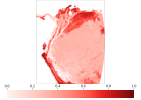

In [100]:
plotMAP(pcasigm[Components="sigPC_var1"], colorm=colormap("reds"), dmin=0, dmax=1,
    oceancol=colorant"white",
    misscol=colorant"white",
    dpi=150)

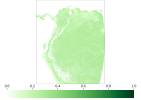

In [101]:
plotMAP(pcasigm[Components="sigPC_var2"], colorm=colormap("greens"), dmin=0, dmax=1,
    oceancol=colorant"white",
    misscol=colorant"white")

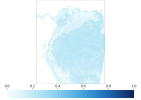

In [102]:
plotMAP(pcasigm[Components="sigPC_var3"], colorm=colormap("blues"), dmin=0, dmax=1,
    oceancol=colorant"white",
    misscol=colorant"white") # misscol=colorant"white",

In [103]:
minimum(skipmissing(pcasigm[:,:,1])), maximum(skipmissing(pcasigm[:,:,1]))

(0.25313136f0, 0.96207017f0)

In [104]:
minimum(skipmissing(pcasigm[:,:,2])), maximum(skipmissing(pcasigm[:,:,2]))

(0.019068716f0, 0.46054468f0)

In [105]:
minimum(skipmissing(pcasigm[:,:,3])), maximum(skipmissing(pcasigm[:,:,3]))

(0.010792308f0, 0.27545634f0)

In [106]:
quantile(skipmissing(pcasigm[:,:,1]),[0.01, .99])

2-element Array{Float64,1}:
 0.2804080545902252
 0.8633400797843933

In [107]:
quantile(skipmissing(pcasigm[:,:,2]),[0.01, .99])

2-element Array{Float64,1}:
 0.07589496798813343
 0.3134177041053774 

In [108]:
quantile(skipmissing(pcasigm[:,:,3]),[0.01, .91])

2-element Array{Float64,1}:
 0.03779849950224161
 0.24152633115649225

## Plotting Figure 4D - RGB map

In [68]:
pcasigm = pcasiglodout[info_PCA="PC_significance"]

ZArray Cube with the following dimensions
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Components_or_Var   Axis with 4 elements: sigPC_var1 sigPC_var2 sigPC_var3 sigPC_var4 
Total size: 176.88 MB


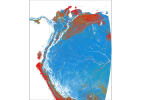

In [69]:
p1 = plotMAPRGB(pcasigm, rgbaxis="Components",
    oceancol=colorant"white",
    misscol=colorant"white",
    c1="sigPC_var1",
    c2="sigPC_var2",
    c3="sigPC_var3",
    cType=RGB)

## Data projected in the PCA space

In [70]:
addprocs(6);

6-element Array{Int64,1}:
  8
  9
 10
 11
 12
 13

In [71]:
workers();

6-element Array{Int64,1}:
  8
  9
 10
 11
 12
 13

In [72]:
@everywhere using MultivariateStats

In [73]:
@everywhere function pcaFx(xout, xin0::Any, maxoutdim=maxd, method=:svd)
    if any(ismissing.(xin0))
        return missing
    else
       xin = convert(Array{Float32}, xin0' |> Matrix) 
        # projection(pca) give the rotation matrix
        xin_pca = fit(PCA, xin; maxoutdim=maxoutdim,  method=method, pratio=1.0)
        t = transform(xin_pca, xin)
        xout .= missing
        for i in 1:min(size(xout,2),size(t,1))
            xout[:,i] .= t[i,:]
        end
    end
end


In [74]:
axispca = CategoricalAxis("Components", ["C1","C2","C3","C4"]) #,"C5"

Components          Axis with 4 elements: C1 C2 C3 C4 

In [75]:
indimspca = InDims("Time","Variable")
outdimspca = OutDims("Time",axispca)

OutDims((ESDL.Cubes.Axes.ByName("Time"), ESDL.Cubes.Axes.ByValue(Components          Axis with 4 elements: C1 C2 C3 C4 )), (), zero, identity, :auto, false, AsArray(), :input, Zarr.NoCompressor(), "", false, 1)

In [76]:
cstd

Collection of ZArray Cube with the following dimensions
Time                Axis with 644 Elements from 2001-01-05T00:00:00 to 2014-12-31T00:00:00
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Variable            Axis with 4 elements: gross_primary_productivity ndvi evi fpar 
Total size: 111.24 GB


In [77]:
#pcacom = mapCube(pcaFx, cstd, 5, indims=indims, outdims=outdims)
@time pcacom = mapCube(pcaFx, cstd, 4, indims=indimspca, outdims=outdimspca)

┌ Warning: There are still cache misses
└ @ ESDL.DAT /Net/Groups/BGI/scratch/lestup/julia_atacama_depots/packages/ESDL/skMpG/src/DAT/DAT.jl:608
Progress: 100%|█████████████████████████████████████████| Time: 0:03:42


250.192142 seconds (711.13 k allocations: 33.416 MiB)


ZArray Cube with the following dimensions
Time                Axis with 644 Elements from 2001-01-05T00:00:00 to 2014-12-31T00:00:00
Components          Axis with 4 elements: C1 C2 C3 C4 
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Total size: 111.24 GB


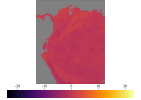

In [78]:
plotMAP(pcacom, time=t, Component="C1")

In [79]:
# saveCube(pcacom[Components="C1"],"pcacomstdTS1pc1km2014_mask")

### Get MSC

In [80]:
@time cmsc = getMSC(pcacom[Components="C1"])

Progress: 100%|█████████████████████████████████████████| Time: 0:00:20


 24.186404 seconds (3.50 M allocations: 175.855 MiB)


ZArray Cube with the following dimensions
MSC                 Axis with 46 Elements from 1900-01-01T00:00:00 to 1900-12-27T00:00:00
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Total size: 1.99 GB


In [81]:
@everywhere function maskout(xout, xin, mask)
    xout[:] = xin.*mask
end

In [82]:
indims = InDims("Lon","Lat")
outdims = OutDims("Lon","Lat")

OutDims((ESDL.Cubes.Axes.ByName("Lon"), ESDL.Cubes.Axes.ByName("Lat")), (), zero, identity, :auto, false, AsArray(), :input, Zarr.NoCompressor(), "", false, 1)

In [83]:
workers();

6-element Array{Int64,1}:
  8
  9
 10
 11
 12
 13

In [84]:
rmprocs(workers())

Task (done) @0x00007f96d0ae2bf0

In [85]:
@time cmscm = mapCube(maskout, cmsc, mask, indims=indims, outdims=outdims)

┌ Warning: There are still cache misses
└ @ ESDL.DAT /Net/Groups/BGI/scratch/lestup/julia_atacama_depots/packages/ESDL/skMpG/src/DAT/DAT.jl:608
Progress: 100%|█████████████████████████████████████████| Time: 0:00:39


 41.188557 seconds (8.18 M allocations: 37.019 GiB, 4.89% gc time)


ZArray Cube with the following dimensions
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
MSC                 Axis with 46 Elements from 1900-01-01T00:00:00 to 1900-12-27T00:00:00
Total size: 1.99 GB


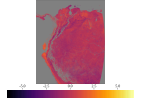

In [86]:
plotMAP(cmscm, MSC=Date(1900, 12, 27))

In [87]:
# saveCube(cmscm, "pcacom1msc1km2014_mask")

## Calculate standard deviation of Seasonal Cycle

In [88]:
axmsc = cmsc.axes[1]

MSC                 Axis with 46 Elements from 1900-01-01T00:00:00 to 1900-12-27T00:00:00

In [89]:
@everywhere function getSDSC(xout, xin, timeax)
    any(ismissing, xin) && return missing
    timedoy = map(x->Dates.dayofyear(x), timeax)
    #xout = zeros(46)
    for i in 1:46 
        idx = findall(x-> x==timedoy[i], timedoy)
        xout[i] = std(map(x->xin[x], idx))
    end
    return xout
end

In [90]:
indimssdsc = InDims("Time")
outdimssdsc = OutDims(axmsc)

OutDims((ESDL.Cubes.Axes.ByValue(MSC                 Axis with 46 Elements from 1900-01-01T00:00:00 to 1900-12-27T00:00:00),), (), zero, identity, :auto, false, AsArray(), :input, Zarr.NoCompressor(), "", false, 1)

In [91]:
@everywhere using Dates, OnlineStats

In [92]:
tall = collect(pcacom.axes[1].values);

In [93]:
pcacom[Components="C1"]

ZArray Cube with the following dimensions
Time                Axis with 644 Elements from 2001-01-05T00:00:00 to 2014-12-31T00:00:00
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Total size: 27.81 GB


In [94]:
@time csdsc = mapCube(getSDSC, pcacom[Components="C1"], tall, indims=indimssdsc, outdims=outdimssdsc)

Progress: 100%|█████████████████████████████████████████| Time: 0:04:45


286.607642 seconds (4.28 G allocations: 359.293 GiB, 20.42% gc time)


ZArray Cube with the following dimensions
MSC                 Axis with 46 Elements from 1900-01-01T00:00:00 to 1900-12-27T00:00:00
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
Total size: 1.99 GB


In [95]:
rmprocs(workers())

┌ Warning: rmprocs: process 1 not removed
└ @ Distributed /buildworker/worker/package_linux64/build/usr/share/julia/stdlib/v1.3/Distributed/src/cluster.jl:1015


Task (done) @0x00007f96cdac35b0

In [96]:
@time csdscm = mapCube(maskout, csdsc, mask, indims=indims, outdims=outdims)

┌ Warning: There are still cache misses
└ @ ESDL.DAT /Net/Groups/BGI/scratch/lestup/julia_atacama_depots/packages/ESDL/skMpG/src/DAT/DAT.jl:608
Progress: 100%|█████████████████████████████████████████| Time: 0:00:35


 35.746138 seconds (3.19 M allocations: 36.782 GiB, 2.32% gc time)


ZArray Cube with the following dimensions
Lon                 Axis with 2760 Elements from -82.99622135 to -60.00464665
Lat                 Axis with 3360 Elements from 13.99613735 to -13.99541735
MSC                 Axis with 46 Elements from 1900-01-01T00:00:00 to 1900-12-27T00:00:00
Total size: 1.99 GB


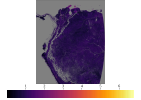

In [97]:
plotMAP(csdscm, MSC=Date(1900, 12, 27))

In [98]:
# saveCube(csdscm,"pcacom1sdsc1km2014_mask")